:::{index} single: Report writing
:::
:::{index} single: Simulations; Report writing
:::
:::{index} single: Scenarios; Report writing
:::
:::{index} single: Simulations; the keep option
:::

:::{index} single: Scenarios; the Keep option
:::

:::{index} single: Keep; the Keep option to retain scenario results
:::



In [46]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [47]:
#This is code to manage dependencies if the notebook is executed in the google colab cloud service
if 'google.colab' in str(get_ipython()):
  import os
  os.system('apt -qqq install graphviz')
  os.system('pip -qqq install ModelFlowIb ipysheet  --no-dependencies ')


In [48]:
# Prepare the notebook for use of modelflow 

# Jupyter magic command to improve the display of charts in the Notebook
%matplotlib inline

# Import pandas 
import pandas as pd

# Import the model class from the modelclass module 
from modelclass import model 

# functions that improve rendering of modelflow outputs
model.widescreen()
#model.scroll_off();

# Report writing and scenario results

`ModelFlow`, is built on the back of  and inherits the functionalities of standard pandas routines and other python libraries like [matplotlib](https://matplotlib.org/), [seaborn](https://seaborn.pydata.org/), [plotly](https://plotly.com/), and [bokeh](https://bokeh.org/). These libraries are well-integrated with dataframes, and offer a wide-range of visualization capabilities. As has been done throughout this manual, they can be used to look at data, compare simulation results among other things. 

`ModelFlow` users are free to employ any Python-based library for visualization purposes. For specific tasks, notably ones that seek to take advantage of `ModelFlow` internal data structures, such as the dataframes holding the results from different simulations and  for tasks common to macroeconoic scenario analysis, `ModelFlow` includes some specific procedures derived from these other packages that may be of interest. In particular, these routines are tailored to utilize `ModelFlow` metadata such as variable descriptions and include specific transformations (like growth rates) and various scenario comparison visualizations that are useful in the analysis of macroeconomic model results.

## Summary

A **report** can be either a **table**, a **plot**  or a **text**. 

| Function | Creates |
|:----------|:-------------|
| `.table()` | A table based on the values in `.basedf` and `.lastdf` DataFrames. |
| `.plot` | One or more plots based on values in `keep_solutions` or in `.basedf` and `.lastdf`|
| `.text` | text, can be subdivided into plain, latex and html text using \<type>\</type> delimiters|

Tables, plots and text can be combined by the `|` operator. This operates only on the same report types and produces a new version of the report.

A **Report container**  can be constructed by the `+` operator. It can contain any mix of tables, plots, text and other report containers.   

Reports and report containers can be stored with `.add_report` and restored by`.get_report`. Stored reports and report containers are dumped together with model and data in `.pcim` when the `.modeldump` function is used. 

Note that stored reports and report containers will store the specification not the actual data and rendering. The specification can be used to create new reports based on the current content. 

Report(containers) can be displayed as string, html or pdf. 



## Load model object and simulation results from Scenario Analysis Chapter
To begin, a solution file that was saved at the end of the previous chapter is loaded, using the by now familiar modelload function.  Because the simulations performed in the previous chapter used the keep option, and because we saved the `mpakwScenarios.pcim` file with the keep option set to true, we will have access to all the simulation results from the previous chapter.

In [49]:
mpak,_ = model.modelload(r'..\models\mpakwScenarios.pcim',run=1)
_ = mpak.smpl(2025,2029)

Zipped file read:  ..\models\mpakwScenarios.pcim


The `.keep_solutions` dictionary can be interrogated to list all of the solutions (the keys) that were performed and stored in the previous chapter and the dataframes that were generated when the simulations were performed (the keys) in the dictionary.

In [50]:
for key,value in mpak.keep_solutions.items():
    print(key)

Baseline
$25 increase in oil prices 2025-27
2.5% increase in C 2025-40
2.5% increase in C 2025-27 -- exog whole period
2.5% increase in C 2025-27 -- exog whole period --KG=True
2.5% increase in C 2025-27 -- temporarily exogenized
1% of GDP increase in FDI and private investment (AF shock)


:::{index} single: Tables
:::

In addition the `mpak` model object includes the `.basedf` and `.lastdf` dataframes, which contain the values of model variables when initially loaded and following the latest simulation respectively.


In addition the `mpak` model object includes the `.basedf` and `.lastdf` dataframes, which contain the values of model variables when initially loaded and following the latest simulation respectively.

Tables are designed to look at reporting the `.basedf` and `.lastdf` so in this section the two dataframes are populated from the kept solutions. 

In [51]:
mpak.basedf = mpak.keep_solutions['Baseline']
mpak.lastdf = mpak.keep_solutions['1% of GDP increase in FDI and private investment (AF shock)']
mpak.smpl(2025,2029);

## The `.table()` function to create tables
:::{index} single: Reports; Tables
:::

This function creates standard tables with a minimum of fuss. It will create tables based on the values in `.basedf` and `.lastdf` DataFrames. By default, it creates tables with growth rates.

The function returns an instance of a class `DisplayVarTableDef`. This class has several useful methods and properties, which will be covered below.


A simple call is shown below. 
 
A **pattern** (pat) which defines some national account variables is created. Here the `*` wildchart is used, allowing this pattern to be used for models of other countries if the model conforms to standard naming conventions: 
 > pat='*NYGDPMKTPKN *NECONPRVTKN  *NEGDIFTOTKN *NEEXPGNFSKN *NEIMPGNFSKN'

Also a **name** for the table is provided. This is used to avoid confusion when different tables are producing file output. 

Now an instance of the `DisplayVarTableDef` class can be created by a statement like this. 

 > tab = mpak.tab(name='My_first_table',pat=pat,title='GDP components,foot='Source: World bank ')

In addition a **title** and a **footnote** is also:

The variable tab contains the data and specification of a table. This in itself don't produce any output, but the `tab` object can be displayed and manipulated in various ways.

In [52]:
pat=  ' *NYGDPMKTPKN *NECONPRVTKN  *NEGDIFTOTKN *NEEXPGNFSKN *NEIMPGNFSKN '
tab = mpak.table(name='My_first_table',pat=pat,title='GDP components',foot='Source: World bank ')

Now there are several possibilities for output: 

### Automatic display of a table in jupyter notebook 
By mentioning the `tab` as the last item in a cell the table will be displayed (using html). Alternative it tab is not the last item it can be displayed with 
 > display(tab)  
 
 In the next cell the table is displayed just by writing the name in the last line

In [53]:
tab

:::{image} tab1.png
    :alt: Menu to start notebooks in subfolders
    :class: bg-primary mb-1
    :width: 70%
    :align: center
:::

This display will be scrollable it there are many years.

### `.show` Show the  table as text
The table can also be converted to text and displayed.

In [54]:
tab.show

GDP components
                         2025   2026   2027   2028   2029
                              --- Percent growth ---     
Real GDP                 2.08   2.42   2.64   4.36   2.91
HH. Cons Real            2.03   2.32   2.48   3.45   2.62
Investment real          1.10   1.46   1.82  12.46   2.98
Exports real             4.37   4.20   4.04   3.88   3.72
Imports real             3.10   3.10   3.02   4.68   2.84
Source: World bank 


### `.pdf` Creates a .pdf version of the table
Or the table can be made to a pdf file. 

In [55]:
tab.pdf() 

:::{image} tab1-pdf.png
    :alt: Menu to start notebooks in subfolders
    :class: bg-primary mb-1
    :width: 90%
    :align: center
:::

The pdf file is displayed in the Jupyter Notebook with the standard pdf viewer and can be downloaded can be downloaded from there. Also the call
 >tab.pdf(xopen=1) 

Will open the pdf file in a separate viewer. 

### `transpose = True` Vertical tables
:::{index} single: Reports; Vertical tables
:::
Sometime tables have the years downward for instance in order to contain more years. This is done by adding the keyword: `transpose = True` when the table is created. In this case any number of years can be displayed, but the number of variables are limited by the width of the paper/screen. 

In [56]:
with mpak.set_smpl(2022,2027):
    tab_t = mpak.table(name='My_first_table',pat=pat,title='GDP components',
                       foot='Source: World bank ',transpose = True)
tab_t.show


GDP components
     Real GDP HH. Cons Real Investment real Exports real Imports real
                          --- Percent growth ---                     
2022     0.66          0.80            0.70         4.71         3.00
2023     1.04          1.09            0.63         4.66         2.86
2024     1.60          1.60            0.79         4.53         2.99
2025     2.08          2.03            1.10         4.37         3.10
2026     2.42          2.32            1.46         4.20         3.10
2027     2.64          2.48            1.82         4.04         3.02
Source: World bank 


### Different transformations of results - Growth Rates, Levels, etc.
:::{index} single: Reports; Tables, transformations of results
:::


When the `tab` function is invoked, it defaults to displaying the growth rates for specified variables. However, it supports various transformations to accommodate a wide range of applications. The specific transformation displayed is determined by the `datatype` argument, which can take the following values:

**Table: Data Types and Their Meanings**


| **datatype**    | **Meaning** |
|:-------------|:------------------------------------------------------------------|
| **growth**  | Growth rate in percent in the most recent dataset (`.lastdf`).   |
| difgrowth   | Change ($\Delta$) in growth rates from `.basedf` to `.lastdf`.   |
| gdppct      | Percentage of GDP in `.lastdf`.                                  |
| qoq_ar      | Quarterly growth annualized                                 |
| difgdppct   | Change ($\Delta$) in the percentage of GDP from `.basedf` to `.lastdf`. |
| level       | Values in `.lastdf`.                                            |
| diflevel    | Change ($\Delta$) in values from `.basedf` to `.lastdf`.         |
| difpctlevel | Percentage change ($\Delta$) in values from `.basedf` to `.lastdf`. |
| difqoq_ar      | change in Quarterly growth annualized from `.basedf` to `.lastdf`                                |
| base        | Values in `.basedf`.                                            |
| basegrowth  | Growth rate in percent in `.basedf`.                            |
| basegdppct  | Percentage of GDP in `.basedf`.                                 |
| baseqoq_ar      | Quarterly growth in `.basedf`                 |


For instance for some balances it makes sense to show the results in percent of GDP. This se done below by `datatype='gdppct'` 

In [57]:
pat_gov = '*GGBALOVRLCN *GGDBTTOTLCN *BNCABFUNDCD'
tab_gov = mpak.table(pat_gov,datatype='gdppct',title='In percent of GDP ',dec=1)
tab_gov.show

In percent of GDP 
                                              2025   2026   2027   2028   2029
                                                   --- Percent of GDP ---     
General Government Revenue, Deficit, LCU mn   -3.0   -3.0   -2.9   -2.8   -2.8
General government gross debt millions lcu    57.0   57.3   57.7   57.1   57.5
Current Account Balance, US$ mn               -3.6   -3.5   -3.4   -3.5   -3.4


### Joining tables with  `|` 
:::{index} single: Reports; Tables, joining tables with  `|` 
:::


 In order to create tables with several datatypes, the content of a (not transposed table) tables can be added together by **`|`**

In [58]:
(tab | tab_gov).show

In percent of GDP 
                                              2025   2026   2027   2028   2029
                                                   --- Percent growth ---     
Real GDP                                      2.08   2.42   2.64   4.36   2.91
HH. Cons Real                                 2.03   2.32   2.48   3.45   2.62
Investment real                               1.10   1.46   1.82  12.46   2.98
Exports real                                  4.37   4.20   4.04   3.88   3.72
Imports real                                  3.10   3.10   3.02   4.68   2.84
                                                   --- Percent of GDP ---     
General Government Revenue, Deficit, LCU mn   -3.0   -3.0   -2.9   -2.8   -2.8
General government gross debt millions lcu    57.0   57.3   57.7   57.1   57.5
Current Account Balance, US$ mn               -3.6   -3.5   -3.4   -3.5   -3.4
Source: World bank 


### `Heading=` create a line with text. 
When constructing comprehensive tables by combining multiple tables, the heading parameter can be used to delineating distinct sections within the combined table. 

In [59]:
pat=  '*NYGDPMKTPKN *NECONPRVTKN  *NEGDIFTOTKN *NEEXPGNFSKN *NEIMPGNFSKN'
pat_gov = '*GGBALOVRLCN *GGDBTTOTLCN *BNCABFUNDCD'

tab_na_base  = mpak.table(pat,    datatype='basegrowth',
                        heading=r'Baseline')
tab_gov_base = mpak.table(pat_gov,datatype='basegdppct')

tab_na       = mpak.table(pat,    datatype='growth',
                        heading=r'Alternative')
tab_gov      = mpak.table(pat_gov,datatype='gdppct')

tab_na_dif   = mpak.table(pat     ,datatype='difgrowth',
                        heading=r'Impact')
tab_gov_dif  = mpak.table(pat_gov ,datatype='difgdppct') 

tab_total    = tab_na_base | tab_gov_base |  tab_na | tab_gov | tab_na_dif | tab_gov_dif

# 
tab_total.show


Table
                                              2025   2026   2027   2028   2029
                                                          Baseline            
                                                --- Base Percent growth ---   
Real GDP                                      2.08   2.42   2.64   2.79   2.91
HH. Cons Real                                 2.03   2.32   2.48   2.59   2.69
Investment real                               1.10   1.46   1.82   2.17   2.51
Exports real                                  4.37   4.20   4.04   3.90   3.77
Imports real                                  3.10   3.10   3.02   2.89   2.78
                                                --- Base Percent of GDP ---   
General Government Revenue, Deficit, LCU mn  -3.05  -2.98  -2.95  -2.92  -2.91
General government gross debt millions lcu   57.02  57.26  57.69  58.26  58.94
Current Account Balance, US$ mn              -3.55  -3.46  -3.40  -3.37  -3.36
                                              

:::{index} single: Boxes; Box 3. Reports and latex 
:::

:::{admonition} Box 3. Reports and latex

In order to create pdf files Latex has to be installed on the machine. For this publication the Miktex package has been uses. More on installing
the framework here: [https://miktex.org/download](https://miktex.org/download) 

The pdf file is located here: `latex/<table name>/<table name>.pdf`. The latex source code is placed in `latex/<table name>/<table name>.tex` In case of errors or if the user want to enhance the output this file can be edited.  
            
:::

:::{admonition} Box 35. test raport 



The pdf file is located here: `latex/<table name>/<table name>.pdf`. The latex source code is placed in `latex/<table name>/<table name>.tex` In case of errors or if the user want to enhance the output this file can be edited.  
            
:::


### Table overrun 
If a table covers many years it not a problem then it is displayed in the Jupyter notebook. but in latex and in print can it be a problem. This can be handled in several ways:

 - drop some middle columns
 - tisplay tables with chunks of data 
 - display a slice of data 


#### Handling Table Overrun in pdf and show

When dealing with tables that cover extensive time periods, such as multiple years, displaying them effectively in Jupyter Notebooks is straightforward. However, in LaTeX documents or printed materials, these tables can easily overrun the page and become impossible to read. To address this issue, several strategies can be employed:

- **Drop Middle Columns**: This involves removing several columns from the middle of the table that may not be critical to the reader’s understanding, helping to condense the table into a more manageable size.
  
- **Display Tables in Chunks**: Break the table into multiple smaller tables, each covering a shorter time span. This not only makes each segment easier to fit on a page but also can help readers digest the information in smaller, more focused increments.

- **Display a Slice of Data**: Rather than showing the entire timeline, you can display a specific segment or 'slice' of the data that is most relevant to the analysis at hand. This approach focuses the reader's attention and avoids overwhelming them with too much information at once.

These methods can significantly enhance the readability and presentation of long tables in formats that are less flexible than interactive digital platforms.



In [60]:
with mpak.set_smpl(2026,2050): 
    tab_long = mpak.table(pat,title='GDP components',name='long_table')

```tab_long``` will display the table as html in jupyters output mode. Here all 
years are displayed and the table can be scrolled. 

In [61]:
tab_long

:::{image} tab-long-html.png
    :alt: Menu to start notebooks in subfolders
    :class: bg-primary mb-1
    :width: 70%
    :align: center
:::

`.show` use standard pandas functionaliuty 

In [62]:
tab_long.show 

GDP components
                         2026   2027   2028  ...   2048   2049   2050
                                    --- Percent growth ---           
Real GDP                 2.42   2.64   4.36  ...   3.31   3.31   3.31
HH. Cons Real            2.32   2.48   3.45  ...   3.16   3.16   3.17
Investment real          1.46   1.82  12.46  ...   4.31   4.30   4.28
Exports real             4.20   4.04   3.88  ...   2.68   2.66   2.64
Imports real             3.10   3.02   4.68  ...   2.78   2.81   2.85


`.pdf` use places a vertical line in order to signal missing columns 

the behavior can be controlled (more to come) 

also timeslice to specify exactly which to display (more to come) 

In [63]:
tab_long.pdf() 

:::{image} tab-long.png
    :alt: Menu to start notebooks in subfolders
    :class: bg-primary mb-1
    :width: 70%
    :align: center
:::

#### `chunk_size=` to split pdf tables. 
If the option `chunk_size` is set. The pdf table will be split into sub tables each with chunk_size columns (except the last table). 

In [64]:
tab_long.set_options(chunk_size=12).pdf() 

:::{image} tab-long-chunk.png
    :alt: Menu to start notebooks in subfolders
    :class: bg-primary mb-1
    :width: 80%
    :align: center
:::

#### Use `timeslice = ` to limit the number of years. 
This allows selection of the years to display. `timeslicce` gives full control over the time for which the data is displayed. Beware, timeslice don't care if years are out of order. It will show what you ask for. 

In [65]:
tab_long.set_options(timeslice=[2026,2040,2028 ,2029,2050]).show

GDP components
                         2026   2040   2028   2029   2050
                              --- Percent growth ---     
Real GDP                 2.42   3.41   4.36   2.91   3.31
HH. Cons Real            2.32   3.17   3.45   2.62   3.17
Investment real          1.46   4.29  12.46   2.98   4.28
Exports real             4.20   2.93   3.88   3.72   2.64
Imports real             3.10   2.58   4.68   2.84   2.85


### `col_desc =`  Userdefined column description 
´.table´ will use a default column description based on the **datatype**. However it can be changed.  

In [66]:
mpak.table(pat,datatype = 'diflevel').show

Table
                        2025   2026   2027        2028        2029
                                  --- Impact, Level ---           
Real GDP                0.09   0.12   0.15  462,356.94  474,302.35
HH. Cons Real           0.08   0.11   0.13  227,277.35  214,784.82
Investment real         0.03   0.04   0.05  336,198.32  361,924.23
Exports real           -0.00  -0.00  -0.00     -530.53   -2,078.90
Imports real            0.05   0.06   0.08  139,488.09  148,662.30


In [67]:
mpak.table(pat,datatype = 'diflevel',
           col_desc     = 'Delta, LCU 2000 base'
                                   ).show

Table
                               2025   2026   2027        2028        2029
                                      --- Delta, LCU 2000 base ---       
Real GDP                       0.09   0.12   0.15  462,356.94  474,302.35
HH. Cons Real                  0.08   0.11   0.13  227,277.35  214,784.82
Investment real                0.03   0.04   0.05  336,198.32  361,924.23
Exports real                  -0.00  -0.00  -0.00     -530.53   -2,078.90
Imports real                   0.05   0.06   0.08  139,488.09  148,662.30


### Arguments to ´.table´
Arguments can of two types, 
 - **Line** which relates to the variables defined by the pattern and the datatype. 
 - **option** which can cover several tables joined by **`|`**. Options can also be set after the creation of a table using the `.set_option()` method. 


**Table: Arguments to ´.table´**

| Argument            | Default Value             | Description                                               | Line/option          |
|---------------------|---------------------------|-----------------------------------------------------------|----------------------| 
| pat                 | '#Headline'               | Pattern with wildcard for variable names                  | Line                 |
| datatype            | 'growth'                  | Defines the data transformation displays (cf. next table) | Line                 |
| mul                 | 1.0                       | Multiplier of values before display                       | Line                 |
| col_desc            | as shown below            | A centered Description of columns (non transposed table)  | Line                 |
| heading             | ''                        | A centered text above columns (non transposed table)      | Line                 |
| rename              | True                      | If True use descriptions else variable names              | Line and option      |
| name                | ''                        | Name for this display.                                    | option               |
| custom_description  | {}                        | Custom description, override default descriptions.        | option               |
| title               | ''                        | Title.                                                    | option               |
| foot                | ''                        | Footer.                                                   | option               |
| transpose           | False                     | If True, transposes the table                             | option               |
| chunk_size          | 0                         | Specifies the number of columns per chunk in tables.      | option                     |
| timeslice           | []                        | Specifies the time slice for data display.                | option                     |
| max_cols            | 6                         | Maximum columns when displayed as string.                 | option                     |
| last_cols           | 1                         | In Latex, the number of last columns in a display slice.  | option                     |
| smpl             | ('','')                      | set smpl for this plot       | option                         |


### Default Values for col_desc

Below is listed the default values for `col_desc` for the different datatypes. As mentioned above, the user can modify both `col_desc` and `heading` if needed. If `col_desc` are set to blank `''`, the line will not show.

| **datatype**   | **col_desc**               |
|:---------------|:---------------------------|
| **growth**     | Percent growth             |
| **difgrowth**  | Impact, Percent growth     |
| **gdppct**     | Percent of GDP             |
| **difgdppct**  | Impact, Percent of GDP     |
| **level**      | Level                      |
| **diflevel**   | Impact, Level              |
| **difpctlevel**| Impact in percent          |
| **qoq_ar**     | Q-Q annualized             |
| **difqoq_ar**  | Impact, Q-Q annualized     |
| **base**       | Base Level                 |
| **basegrowth** | Base Percent growth        |
| **basegdppct** | Base Percent of GDP        |
| **baseqoq_ar** | Base Q-Q annualized        |



## The `.plot` function to plot scenarios. 
:::{index} single: Reports; Plots
:::

A close sibling of the `.table` function this function creates standard plots with a minimum of fuss. It will create plots based on the values in either ´.keep_solutions´ or `.basedf` and `.lastdf` DataFrames. By default, it creates tables with growth rates.

The function returns an instance of a class `DisplayVarFigDef`. 

A simple call is shown below. 
 
A **pattern** (pat_plot) which defines some variables is created. Here the `*` wildchart is used, allowing this pattern to be used for models of other countries if the model conforms to standard naming conventions: 
 > pat_plot=  '*NYGDPMKTPKN *NECONPRVTKN  '

Also a **name** for the table is provided. This is used to avoid confusion when different tables are producing file output. 

Now an instance of the `DisplayVarFigDef` class can be created by a statement like this. 

 > fig = mpak.plot(pat_plot,name='My first plot')

In addition a **title** is also provided:

The variable fig contains the data and specification of a several plots. This in itself don't produce any output, but the `fig` object can be displayed and manipulated in various ways.


As plots typical show more years than a table the `smpl`is set for a longer periode. 

In [68]:
mpak.smpl(2020,2050)
pat_plot=  '*NYGDPMKTPKN *NECONPRVTKN  '
fig = mpak.plot(pat_plot,name='My_first_plot')

### `.show` Show the  plot

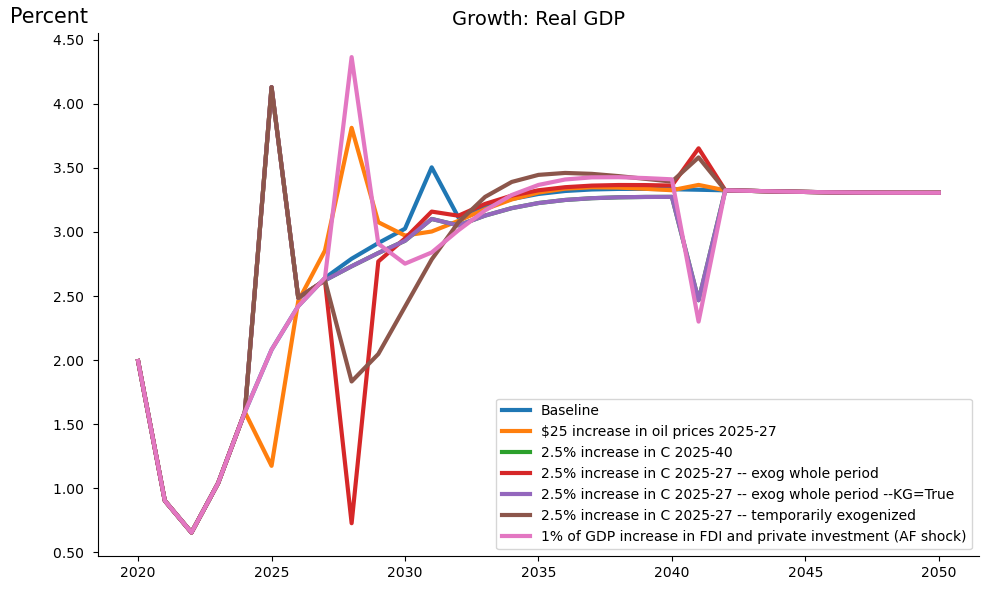

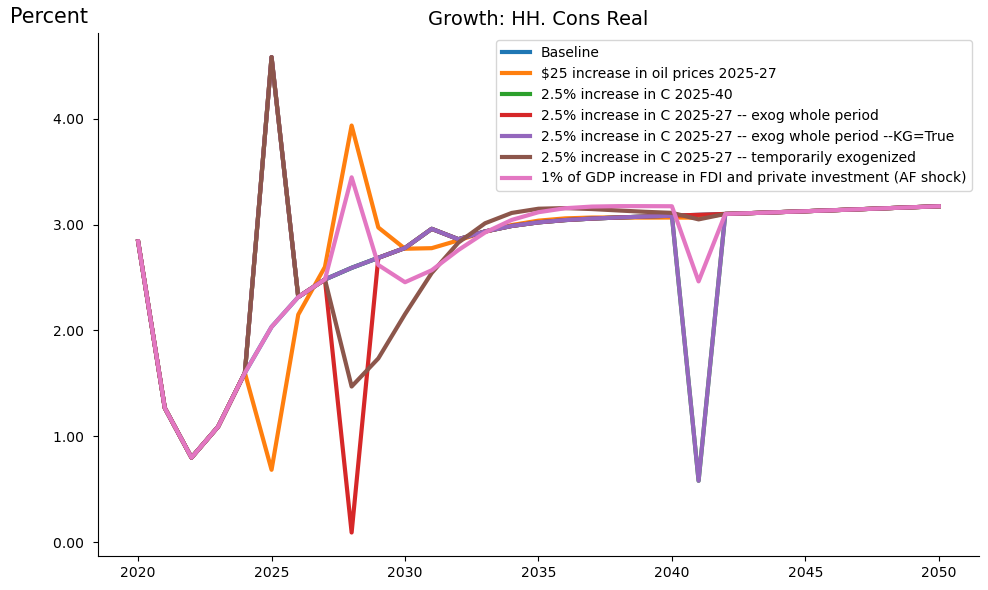

In [69]:
fig.show

### Automatic display of plots
Just like tables plots can be automatic displayed just by mentioning the variable as the last line or by: 
 > display(fig)
 
 The plots will be shown in a tabbed "accodium" so the user can select on which plot to focus. 

In [70]:
fig

Accordion(children=(HTML(value='<?xml version="1.0" encoding="utf-8" standalone="no"?>\n<!DOCTYPE svg PUBLIC "…

:::{image} fig.png
    :alt: Menu to start notebooks in subfolders
    :class: bg-primary mb-1
    :width: 70%
    :align: center
:::

### `.pdf` Creates a .pdf version of the plots
As shown below

In [71]:
fig.pdf() 

:::{image} fig-pdf.png
    :alt: Menu to start notebooks in subfolders
    :class: bg-primary mb-1
    :width: 70%
    :align: center
:::

### Arguments to ´.plot´
Arguments can of two types, 
 - **Line** which relates to the variables defined by the pattern and the datatype. 
 - **option** which can cover several plots joined by **`|`**. Options can also be set after the creation of a plot using the `.set_option()` method. 


**Table: Arguments to ´.plot´**
| Argument           | Default Value             | Description   |Line / option                           |
|--------------------|---------------------------|----------------------------------------|----------------------|
| pat                | '#Headline'               | Pattern with wildcard for variable names | Line  |
| datatype           | 'growth'                  | Defines the datatransformation displayes (cf. next table)     | Line                         |
| mul                | 1.0                       | Multiplier of values before display             | Line                         |
| rename             | True                      | If True use descriptions else variable names    | Line and option                         |
| name               | ''                        | Name for this display.                           | option                         |
| custom_description | {}                        | Custom description, override default descriptions. | option                         |
| title              | ''                        | Title (used when samefig=True).                  | option                         |
| samefig            | False                     | If True, displays all chart in the same plot area. | option                         |
| ncol               | 2                         | Number of columns when samefig=True.            | option                         |
| size               | (10, 6)                   | Specifies the size of each chart                | option                         |
| legend             | True                      | If True, includes a legend in the display.       | option                         |
| smpl             | ('','')                      | set smpl for this plot       | option                         |



**Table: Data Types and Their Meanings**
| **datatype**    | **Meaning** |
|:-------------|:------------------------------------------------------------------|
| **growth**  | Growth rate in percent in the most recent dataset (`.lastdf`).   |
| difgrowth   | Impact ($\Delta$) in growth rates   |
| gdppct      | Percentage of GDP                               |
| difgdppct   | Impact ($\Delta$) in the percentage of GDP |
| level       | Values                                            |
| diflevel    | Impact ($\Delta$) in values         |
| difpctlevel | Percentage impact ($\Delta$) in values |
| qoq_ar      | Quarterly growth annualized                                 |
| difqoq_ar      | change in Quarterly growth annualized from `.basedf` to `.lastdf`                       |
    


### Using ´samefig=True´ to several plots into one figure. 
This can be useful to collect several plots into one file. 

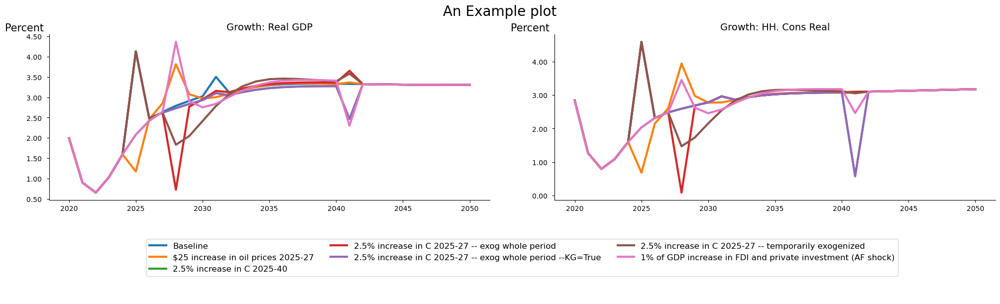

In [72]:
fig.set_options(samefig=True,title='An Example plot').show

### Joining plots with  `|` 
:::{index} single: Reports; Plots, joining plots with  `|` 
:::


 In order to create plots with several datatypes, the content can be joined together by **`|`**. Just like the tables. 

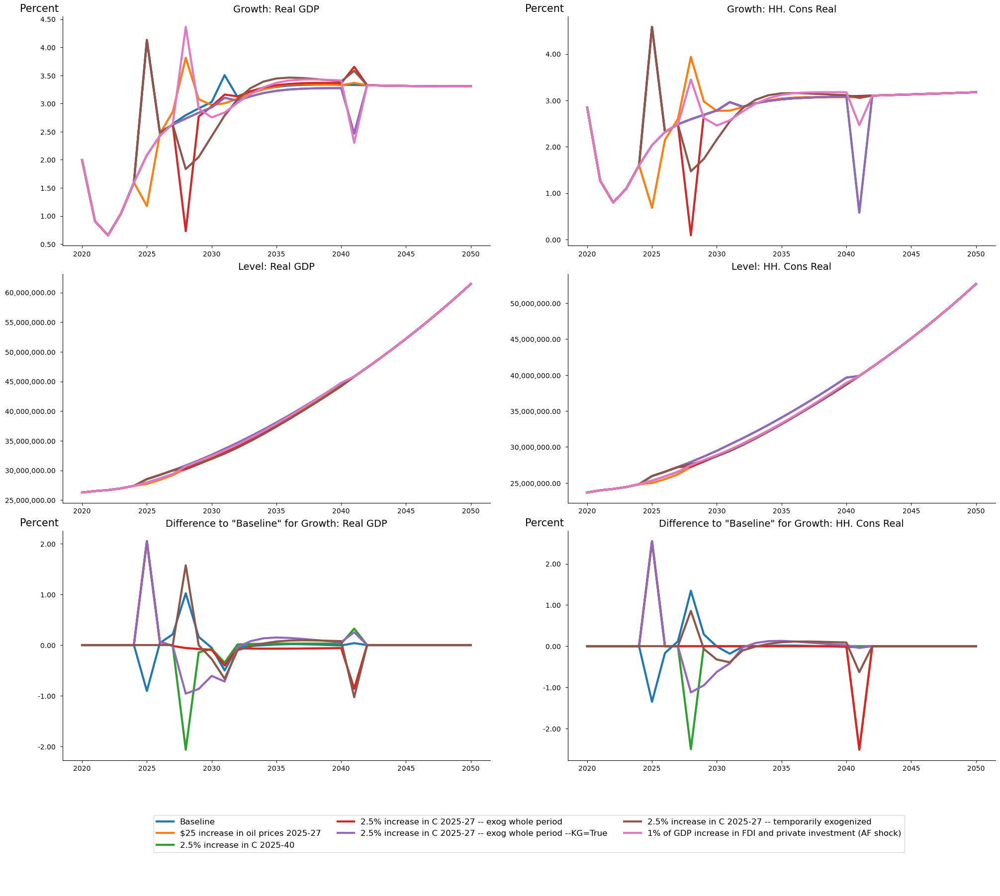

In [73]:
fig1 = mpak.plot(pat_plot,name='growth')
fig2 = mpak.plot(pat_plot,datatype='level',name='Level',)
fig3 = mpak.plot(pat_plot,datatype='difgrowth',name= 'dif')
fig_join = (fig1 | fig2 | fig3).set_options(samefig=True,name='fig_join')
fig_join.show

### Plotting selected scenarios

This can be done by using:

> with mpak.keepswitch(scenarios=scenario_pattern):

Where `scenario_pattern` is a list of scenarios separated by '|'

:::{admonition} Tip
:class: tip
To find all names of the stored scenarios use:

> mpak.keep_solutions.keys()
:::


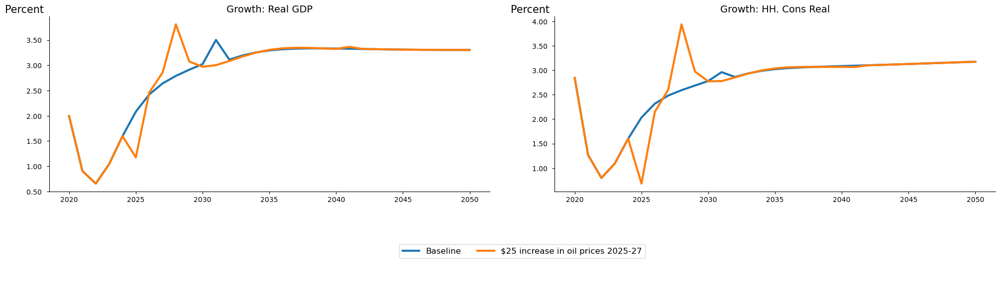

In [74]:
with mpak.keepswitch(scenarios='Baseline|$25 increase in oil prices 2025-27'):
    mpak.plot(pat_plot,name='fig_select',datatype='growth',samefig=True).show


### Plotting `.basedf` and  `.lastdf`
This can be done by using: 
> with mpak.keepswitch(base_last=True):
as explained **somewhere else** 

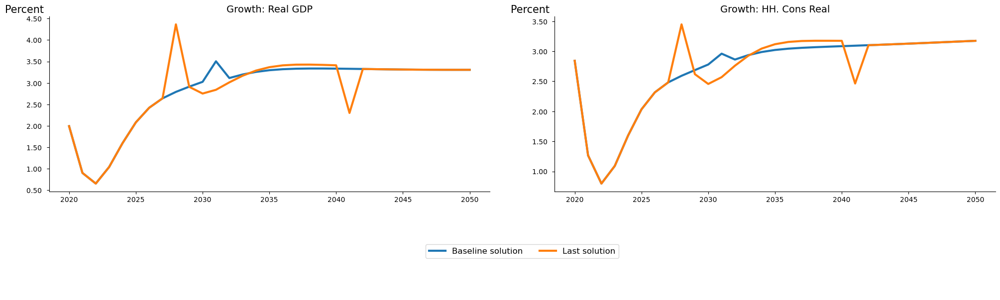

In [75]:
with mpak.keepswitch(base_last=True):
    fig.set_options(samefig=True,name='fig_df').show

### `by_var=False`  scenario plots instead of variable plots

As default, a plot is created for each variable in the `pat` pattern. Each plot shows a line for each scenario. By setting `by_var=False`, a plot is created for each scenario and each plot shows a line for each variable. As summarized below: 

| **by_var** | **a plot for each** | **a line in each plot for each** |
|------------------|---------------------|---------------------|
| **True** (default) | Variable            | Scenario            |
| False             | Scenario            | Variable            |

In the example below the **legend** and **mul** arguments are also in play. 
 - **legend=False**  places the explanation to the right of the line
 - **mul=1/1_000_000** will reduce all values by 1/1_000_000
 
 Notice that python allows large numbers to be split by `_` which makes the number more readable. 


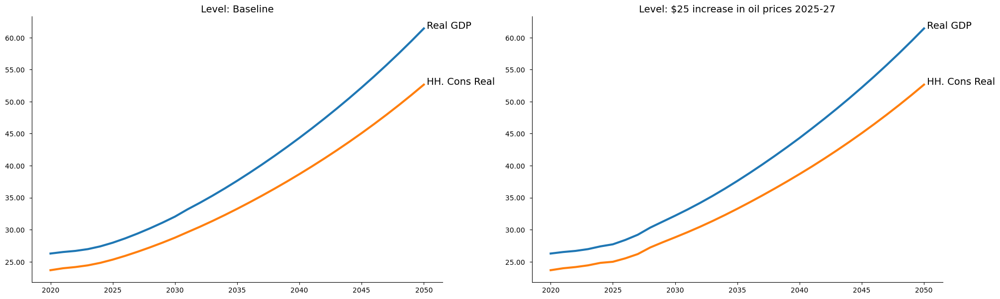

In [76]:
with mpak.keepswitch(scenarios='Baseline|$25 increase in oil prices 2025-27'):
    mpak.plot(pat_plot,name='fig_by_scenario',
                                datatype='level',samefig=True,
                               by_var=False,legend=False,mul=1/1_000_000).show

### `.savefigs()` Saving plots in other formats. 

Plots are created using the `matplotlib` library. This enables saving the charts in a number of formats. So if the charts are 
going to be used further downstream it can be saved and included in most applications. 

| **Parameter**      | **Type**  | **Description**                                                                                        | **Default**       |
|--------------------|-----------|--------------------------------------------------------------------------------------------------------|-------------------|
| `location`         | `str`     | The  folder in which to save the charts.                                                           | `'./graph'`       |
| `experimentname`   | `str`     | A subfolder under `location` where charts are saved.                                                   | `'experiment1'`   |
| `addname`          | `str`     | An additional name added to each figure filename.                                                      | `''` (empty string) |
| `extensions`       | `list`    | A list of  file extensions for saving the figures.                                               | `['svg']`         |
| `xopen`            | `bool`    | If `True`, open the saved figure locations in a web browser.                                           |                   |


The formats for which the charts can be saved are: 

| **Extension**     | **Description**                             |
|-------------------|---------------------------------------------|
| `.png`            | Portable Network Graphics                   |
| `.jpg` or `.jpeg` | Joint Photographic Experts Group            |
| `.tif` or `.tiff` | Tagged Image File Format                    |
| `.bmp`            | Bitmap                                      |
| `.gif`            | Graphics Interchange Format                 |
| `.svg`            | Scalable Vector Graphics                    |
| `.pdf`            | Portable Document Format                    |
| `.eps`            | Encapsulated PostScript                     |
| `.ps`             | PostScript                                  |
| `.raw`            | Raw image data                              |
| `.rgba`           | Raw RGBA bitmap                             |
| `.pgf`            | Portable Graphics Format                    |

So `extensions=['png','pdf']` will save the charts in these formats.  


An example: 

In [77]:
fig_for_saving = mpak.plot(pat_plot,name='for_saving')
fig_for_saving.savefigs() 

'Saved at: graph/experiment1'

### for Andrew: New xtics for short smpl has been inplementet
In the next cell a long and short plot is shown and both works fine now. 

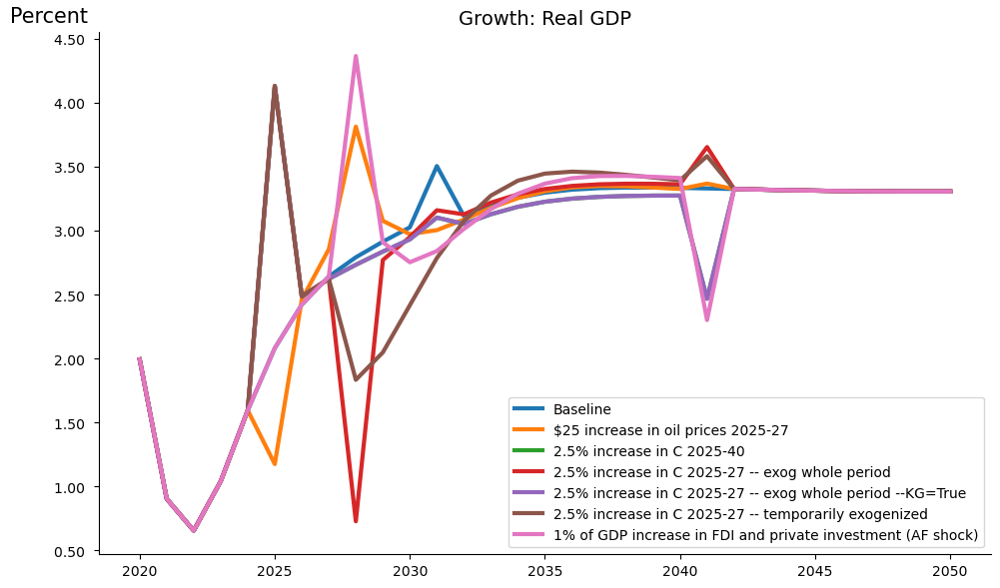

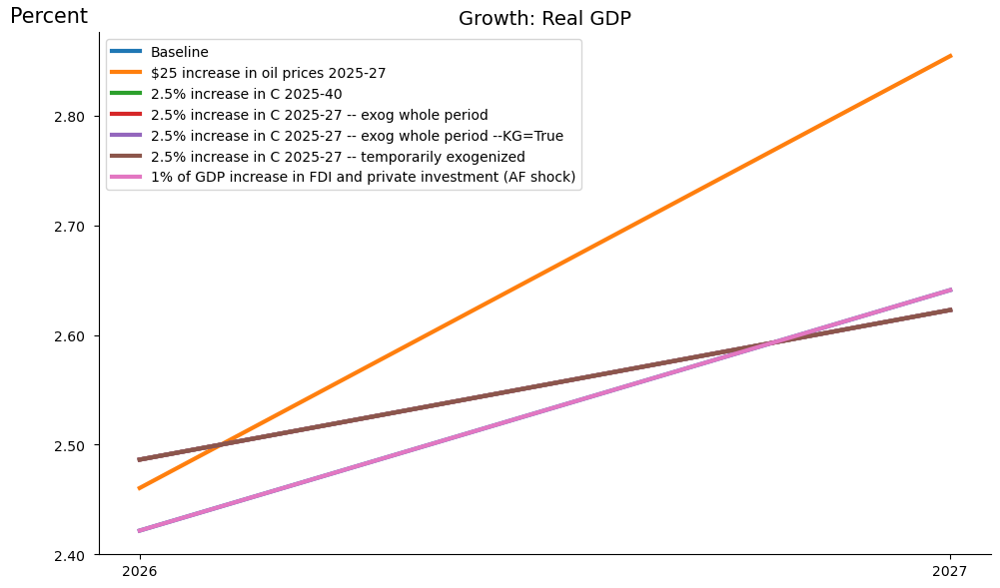

In [78]:
mpak.smpl(2020,2050)
mpak.plot('*NYGDPMKTPKN').show
mpak.plot('*NYGDPMKTPKN',smpl=(2026,2027)).show


## Creating report containers by **`+`**
The `+` operator can be used to create **Report containers** from tables, plots, text and other report containers. Compared to the join operator ´|´ the reports in a container can contain reports with different time frame. 

Text can be added to the container just by creating a strng Also as the output can be produced in both html and latex/pdf. Different text for html and latex can be specified. 

An example is shown below

```rap1 = (fig.set_options(samefig=True)+tab+tab_t).set_name('small report')``` 

Creates a new report 

```fig.set_options(samefig=True)``` creates a new matplotlib figure where the  charts in fig - wich was defined above - are all put into.  This is then added to the two tables ```tab``` with years as columns and ```tab_t```with years as rows.

```.set_name('small report')``` will give the container a name. When a container is saved at the report repo the name is used as key. So we want a unique name.  
when the container is saved. 

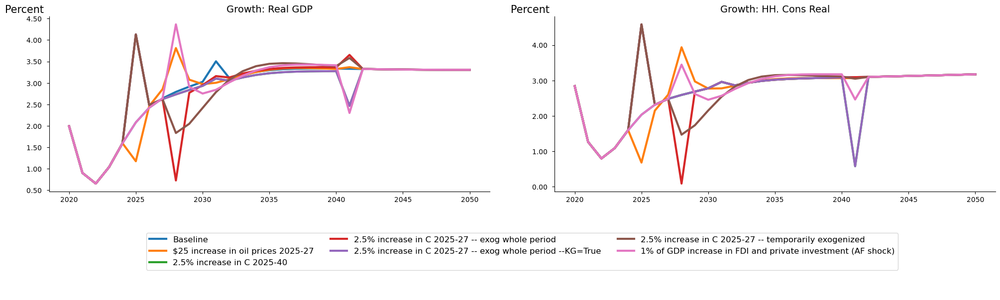



GDP components
                         2025   2026   2027   2028   2029
                              --- Percent growth ---     
Real GDP                 2.08   2.42   2.64   4.36   2.91
HH. Cons Real            2.03   2.32   2.48   3.45   2.62
Investment real          1.10   1.46   1.82  12.46   2.98
Exports real             4.37   4.20   4.04   3.88   3.72
Imports real             3.10   3.10   3.02   4.68   2.84
Source: World bank 


GDP components
     Real GDP HH. Cons Real Investment real Exports real Imports real
                          --- Percent growth ---                     
2022     0.66          0.80            0.70         4.71         3.00
2023     1.04          1.09            0.63         4.66         2.86
2024     1.60          1.60            0.79         4.53         2.99
2025     2.08          2.03            1.10         4.37         3.10
2026     2.42          2.32            1.46         4.20         3.10
2027     2.64          2.48            1.82       

In [79]:
rap1 = (fig.set_options(samefig=True)+tab+tab_t).set_name('small report')
rap1.show 

### A report with different text for pdf/latex, html and show
In the next example the text will result in different output depending on how it is displayed. 




Here we se the growth rates in the different scenarios 
First a chart 





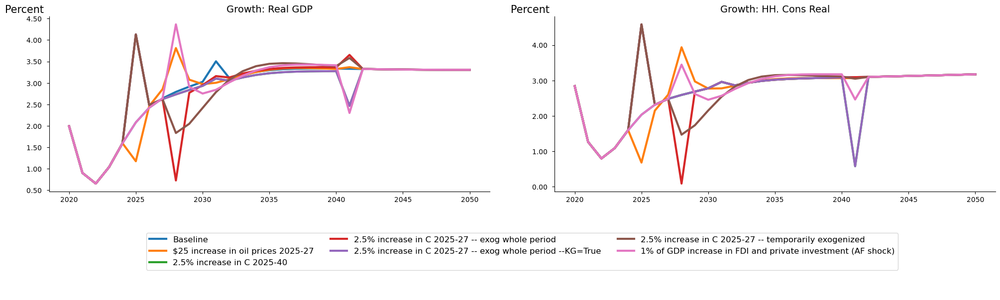



Then a table



GDP components
     Real GDP HH. Cons Real Investment real Exports real Imports real
                          --- Percent growth ---                     
2022     0.66          0.80            0.70         4.71         3.00
2023     1.04          1.09            0.63         4.66         2.86
2024     1.60          1.60            0.79         4.53         2.99
2025     2.08          2.03            1.10         4.37         3.10
2026     2.42          2.32            1.46         4.20         3.10
2027     2.64          2.48            1.82         4.04         3.02
Source: World bank 


In [80]:
rap2 =  (r'''
Here we se the growth rates in the different scenarios 
First a chart 
<latex>
\textbf{Here we se the growth rates in the different scenarios}
</latex>
<html>
<h1>Here we se the growth rates in the different scenarios</h1>
</html>
''' + 
fig.set_options(samefig=True)+
r'''Then a table
<latex>
\textbf{Then a table}
</latex>
<html>
<h1>And a table</h1>
</html>''' +        
tab_t).set_name('report_with_text')
rap2.show   

## `.reports` Stored report definitions for later use
The definitions of the different tables (and later charts) can be stores in a 
dictionary called `.reports` In this way the definitions can be reused at a later state. 
Notice it is the definition not the content of the table which is stored.So when applied in another model class instance the result will reflect state of play at this instance.  

Also the `.report` dict is saved when the model is dumped with `.modeldump` and restored when the function `model.modelload()` is used to load a model. 

### `.add_report` add a report specification to the `.reports` dictionary. 

In [81]:
mpak.add_report([tab_long,rap1,rap2])

Reports added to report repo: long_table, small_report, report_with_text


In [82]:
mpak.reports.keys() 

dict_keys(['long_table', 'small_report', 'report_with_text'])

### `.get_report` create a report from a stored specification. 

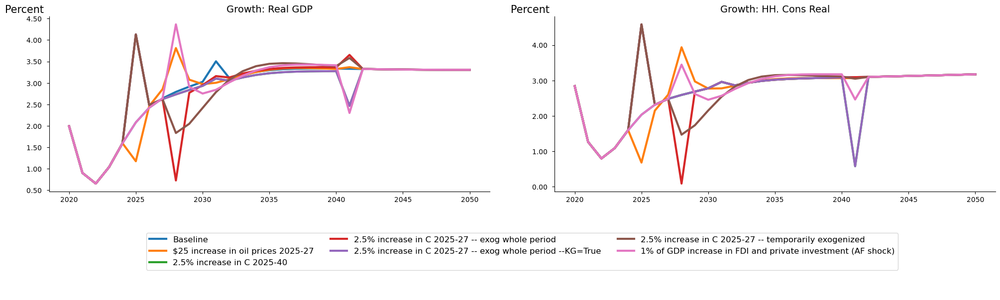



GDP components
                         2025   2026   2027   2028   2029
                              --- Percent growth ---     
Real GDP                 2.08   2.42   2.64   4.36   2.91
HH. Cons Real            2.03   2.32   2.48   3.45   2.62
Investment real          1.10   1.46   1.82  12.46   2.98
Exports real             4.37   4.20   4.04   3.88   3.72
Imports real             3.10   3.10   3.02   4.68   2.84
Source: World bank 


GDP components
     Real GDP HH. Cons Real Investment real Exports real Imports real
                          --- Percent growth ---                     
2022     0.66          0.80            0.70         4.71         3.00
2023     1.04          1.09            0.63         4.66         2.86
2024     1.60          1.60            0.79         4.53         2.99
2025     2.08          2.03            1.10         4.37         3.10
2026     2.42          2.32            1.46         4.20         3.10
2027     2.64          2.48            1.82       

In [83]:
mpak.get_report('small_report').show  

### Reports are stored in `.pcim` files, and restored when a model is loaded
When a report has been saved it will be dumped together with equations, data and other information when a `.modeldump` is performed. This allows 
the user to easy to recreate the table or chart with other scenarios. 

So first dump the model and data: 

In [84]:
mpak.modeldump('testpak',keep=True)

Then read the model and data into new variables. 

In [85]:
xpak,baseline = model.modelload('testpak',run=True  )

Zipped file read:  testpak.pcim


In [86]:
xpak.basedf = xpak.keep_solutions['Baseline']
xpak.lastdf = xpak.keep_solutions['1% of GDP increase in FDI and private investment (AF shock)']

Now the saved tables can be recreated 

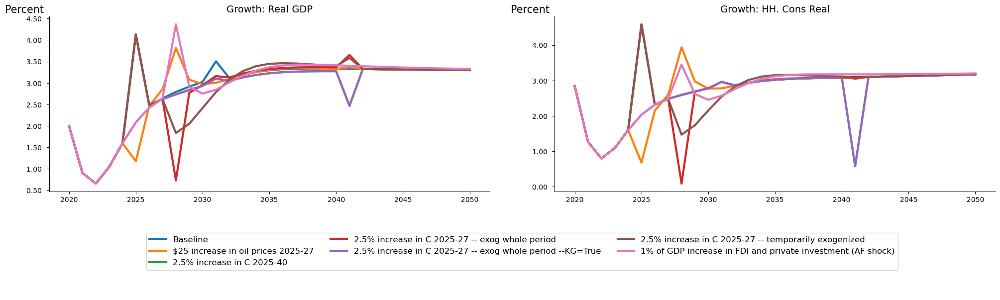



GDP components
                         2025   2026   2027   2028   2029
                              --- Percent growth ---     
Real GDP                 2.08   2.42   2.64   4.36   2.91
HH. Cons Real            2.03   2.32   2.48   3.45   2.62
Investment real          1.10   1.46   1.82  12.46   2.98
Exports real             4.37   4.20   4.04   3.88   3.72
Imports real             3.10   3.10   3.02   4.68   2.84
Source: World bank 


GDP components
     Real GDP HH. Cons Real Investment real Exports real Imports real
                          --- Percent growth ---                     
2022     0.66          0.80            0.70         4.71         3.00
2023     1.04          1.09            0.63         4.66         2.86
2024     1.60          1.60            0.79         4.53         2.99
2025     2.08          2.03            1.10         4.37         3.10
2026     2.42          2.32            1.46         4.20         3.10
2027     2.64          2.48            1.82       

In [87]:
xpak.get_report('small_report').show